## Fitting the GMOS data cube with PySpecKit

1. Exploring the Data Cube
2. Checking PyParadise Stellar and Emission Line Fits
3. Checking PPXF Emission Line Fits

In [1]:
#paths
path_to_beads = '/Users/osaseomoruyi/Dropbox (Harvard University)/BeadsMultiwavelength/'

In [111]:
#system
from __future__ import division
from itertools import repeat
import os
import glob
import sys

#numpy
import numpy as np

#matplotlib 
import matplotlib.pylab as plt
from matplotlib import cm
from matplotlib.colors import LogNorm
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.axes as maxes
import pylab as pl
%matplotlib inline

#astropy
from astropy.io import ascii
from astropy.io import fits
from astropy import wcs
from astropy.wcs import WCS
import astropy.units as u
from astropy.coordinates import Angle
import astropy.constants as const

#seaborn
import seaborn as sns 

from spectral_cube import SpectralCube

import importlib

#spectral fitting
import pyspeckit

# #warnings
import warnings
warnings.filterwarnings("ignore")


In [3]:
#paths
fig_path = path_to_beads + 'Figures/paper/'
gmos_data_directory = path_to_beads + 'Analysis/gmosBeads/'

fits_path = path_to_beads + 'Analysis/gmosBeads/products/'

In [4]:
#import my own functions: you can see them in full in the utils folder
util_path = path_to_beads + 'Notebooks/Beads20/utils/'
sys.path.append(util_path)

import plotting_functions as pf
import science_functions as sf

In [5]:
importlib.reload(sf)


<module 'science_functions' from '/Users/osaseomoruyi/Dropbox (Harvard University)/BeadsMultiwavelength/Notebooks/Beads20/utils/science_functions.py'>

In [6]:
#About SDSS 1531
sf.sdss1531_dict

{'name': 'SDSS J1531+3414',
 'ra': 232.7936938,
 'dec': 34.2404172,
 'radius': 2.5,
 'z': 0.335,
 'cz': 100430.47}

In [7]:
#plot style
pf.styleplots()

### 1. Plot Integrated Intensity Map of Data Cube

In [8]:
#Field of View Cube
fov = gmos_data_directory + 'reduced/SDSSJ1531+3414.acube.fits'
hdu, hdr, w = pf.open_fits(fov)

#create integrated intensity map
mom0 = hdu.data[0,:,:]
for channel in range(1,4573):                
    mom0 += hdu.data[channel,:,:]



In [9]:
#HST Files
hst_files = glob.glob(path_to_beads + '/Analysis/hst_data/h*')
#HST
ff606 = hst_files[0]
ff390 = hst_files[1]

f606 = fits.open(ff606)[0]
f390 = fits.open(ff390)[0]

hst_hdr = f390.header
hst_wcs = WCS(hst_hdr)

The following kwargs were not used by contour: 'rasterized'


(31.0, 0.0)

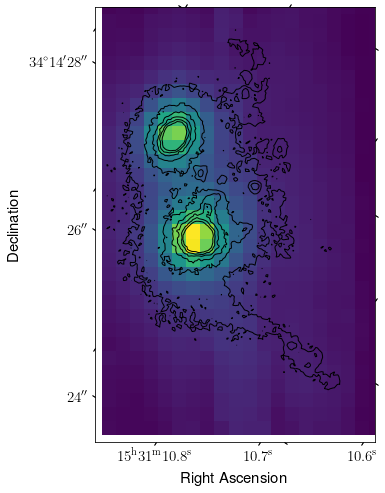

In [10]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 8), subplot_kw={'projection':w, 'slices':('x', 'y', 0)})
ax.imshow(mom0)
pf.labels(ax, hdr)

#HST Contours
pf.overlay(ax, f606, 1, vmin=0.035, vmax=0.3, contours=True, cont_color='k', lw=1)

plt.xlim(20,0)
plt.ylim(31, 0)

#### FOV and Spectral Resolution

In [11]:
#FOV: 5" x 3"
# print(pf.distance(5 * u.arcsec, hdr))
# print(pf.distance(3.5 * u.arcsec, hdr))

In [12]:
#Spectral Resolution
delta_lambda = hdr['CDELT3']

num_spectral_elements = np.shape(hdu.data.T)[2]
wavelength =  (np.arange(num_spectral_elements) - (hdr['CRPIX3'] - 1)) * hdr['CDELT3'] + hdr['CRVAL3']

red_spectral_resolution = wavelength[-1]/delta_lambda
blue_spectral_resolution = wavelength[0]/delta_lambda

print(red_spectral_resolution)
print(blue_spectral_resolution)

12857.714285716438
8285.714285716438


### 2. Fit With PySpeckit

In [135]:
spectral_line_dict = {
# abs'Ne IV': 2439.5,
#                      'Mg II': 2799.117,   ## Lines blueward of H-delta are just too blue for our wavelength coverage
#                      'Ne V': 3346.79,
#                      'Ne VI': 3426.85,
#                      'O II 3727': 3727.092,
#                      'O II 3729': 3729.875,
#                      'He I': 3889.0,
#                      'S II 4072': 4072.3,
                     'Hgamma': 4341.68,
                     'Hbeta': 4862.68,
                     'OIII 4960': 4958.9,
                     'OIII 5007': 5006.84,
                      'OI 6300': 6300.3,
                      'NII 6583': 6583.45,
                      'NII 6548': 6548.05,
                      'SII 6717': 6716.44,
                      'SII 6730': 6730.81,
                      'Halpha':6562.80 ,
                     }

In [33]:
#create new fits cube with better header
fov = gmos_data_directory + 'reduced/SDSSJ1531+3414.acube.fits'
hdu, hdr, w = pf.open_fits(fov)

hdu.header['CTYPE3'] = ('WAVE', 'wavelength axis in Angstroms')
hdu.writeto(gmos_data_directory + 'reduced/fhdr_SDSSJ1531+3414.acube.fits', overwrite=True)

In [32]:
hdu.header.comments['CTYPE3']

'wavelength axis in Angstroms'

In [77]:
fgmos = gmos_data_directory + 'reduced/fhdr_SDSSJ1531+3414.acube.fits'
cube = pyspeckit.Cube(fgmos)

In [94]:
6583.45 * (1+zh)

8788.90575

In [145]:
#the rest wavelength for Halpha as a function of redshift
zh = 0.335
ha_z = (spectral_line_dict['Halpha'] * (1+zh) * u.AA).value
o3_z = (spectral_line_dict['OIII 5007'] * (1+zh) * u.AA).value

#### Fit Hbeta Line

In [146]:
#estimate a reasonable maximum doppler shift 
c = const.c.to(u.km/u.s) # Speed of light
lambda_0 = spectral_line_dict['OIII 5007']* u.AA # Rest wavelength of hydrogen alpha
dv = 1200 * u.km/u.s # Change in velocity

dl = lambda_0 * dv / c
print(dl)

20.04122465282299 Angstrom


In [147]:
# Slice the cube_07 over the wavelength range you'd like to fit
cube_o3 = cube.slice(o3_z-20,o3_z+20,unit='m') #its actually amstrongs

In [148]:
print(np.nanmin(cube_o3.cube))

-0.0011594498


In [149]:
#add ofsset to prevent negative valuses
#conver to easy flux units
yint = 1
mint = 1000

cube_o3.cube += yint
cube_o3.cube *= mint

In [150]:
np.nanmin(cube_o3.cube)

998.8406

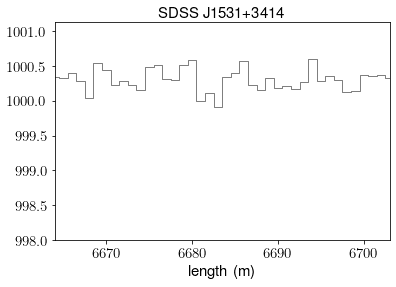

In [151]:
#bright pixel in qfv
x,y = 8, 13
cube_o3.plot_spectrum(x,y, ymin=998)

In [129]:
#test fit on the brightest spaxel, sleected in qfitsview
cube_o3.specfit(fittype='vheightgaussian',guesses=[1000.3,4.4,8752.4,1.18],quiet=False,save=False)

Iter       1    CHI-SQUARE =  1.735588737  DOF =  50
   HEIGHT0 = 1000.3  
   AMPLITUDE0 = 4.4  
   SHIFT0 = 8752.4  
   WIDTH0 = 1.18  
Iter       2    CHI-SQUARE =  1.649777019  DOF =  50
   HEIGHT0 = 1000.267378  
   AMPLITUDE0 = 4.38761176  
   SHIFT0 = 8752.410369  
   WIDTH0 = 1.181126048  
Iter       3    CHI-SQUARE =  1.649596614  DOF =  50
   HEIGHT0 = 1000.267054  
   AMPLITUDE0 = 4.382801031  
   SHIFT0 = 8752.410716  
   WIDTH0 = 1.184014861  
Iter       4    CHI-SQUARE =  1.649582336  DOF =  50
   HEIGHT0 = 1000.267034  
   AMPLITUDE0 = 4.382509556  
   SHIFT0 = 8752.411489  
   WIDTH0 = 1.184196219  
Iter       5    CHI-SQUARE =  1.649581208  DOF =  50
   HEIGHT0 = 1000.267009  
   AMPLITUDE0 = 4.382137328  
   SHIFT0 = 8752.411538  
   WIDTH0 = 1.18441643  
Iter       6    CHI-SQUARE =  1.649581119  DOF =  50
   HEIGHT0 = 1000.267007  
   AMPLITUDE0 = 4.382104308  
   SHIFT0 = 8752.411596  
   WIDTH0 = 1.18443603  
Iter       7    CHI-SQUARE =  1.649581112  DOF =  50
   

In [130]:
# estimate the std where the spectrum is free of
# spectral lines.  The std variable will be used to estimate the S/N of a line
# during fiteach.
std = cube_o3.stats((8780,8790))['std']

In [132]:
cube_o3.fiteach(use_nearest_as_guess=False,
                guesses=[1000.3,4.4,o3_z,1.18],
                fittype='vheightgaussian',
                integral=False,
                negamp=False,
                verbose_level=2,
                errspec=np.ones(cube_o3.shape)*std,
                parlimited=[(False,False), (False,False), (True,True),
                            (True,True)],
                parlimits=[(1000,1001), (1,6), (o3_z - dl.value, o3_z + dl.value), (0, 5)],
                fixed=[False, False, False, False],
                signal_cut=3,
                start_from_point=(x,y))

INFO: Fitting up to 620 spectra [pyspeckit.cubes.SpectralCube]
INFO: Using input guess [pyspeckit.cubes.SpectralCube]
INFO: Finished fit      1 of    620 at (   8,  13) s/n=24837.7. Elapsed time is 0.1 seconds.  %0 [pyspeckit.cubes.SpectralCube]
INFO: Left region selection unchanged.  xminpix, xmaxpix: 0,54 [pyspeckit.spectrum.interactive]
INFO: Using input guess [pyspeckit.cubes.SpectralCube]
INFO: Finished fit      1 of    620 at (  13,   8) s/n=24746.1. Elapsed time is 0.5 seconds.  %0 [pyspeckit.cubes.SpectralCube]
INFO: Finished fit      2 of    620 at (  13,   7) s/n=24738.1. Elapsed time is 0.8 seconds.  %0 [pyspeckit.cubes.SpectralCube]
INFO: Finished fit      3 of    620 at (  13,   9) s/n=24750.0. Elapsed time is 1.1 seconds.  %0 [pyspeckit.cubes.SpectralCube]
INFO: Finished fit      4 of    620 at (  12,   8) s/n=24738.2. Elapsed time is 1.2 seconds.  %1 [pyspeckit.cubes.SpectralCube]
INFO: Finished fit      5 of    620 at (  14,   8) s/n=24759.9. Elapsed time is 1.5 seconds

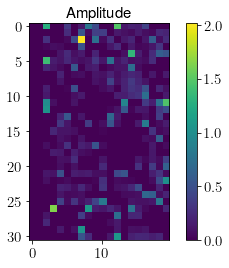

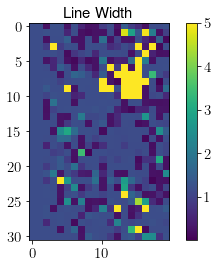

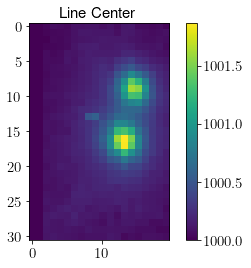

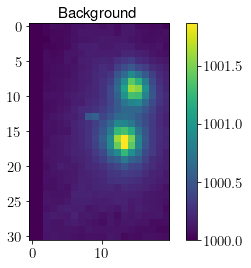

In [133]:
# plot the fits as images (you can click on background image to see the spectra + fits)
# amp_max = np.max(cube_o3.parcube[1,:,:])
cube_o3.mapplot(estimator=1)
cube_o3.mapplot.axis.set_title("Amplitude")

cube_o3.mapplot.figure=pl.figure(5)
cube_o3.mapplot(estimator=3)
cube_o3.mapplot.axis.set_title("Line Width")

cube_o3.mapplot.figure=pl.figure(6)
cube_o3.mapplot()
cube_o3.mapplot.axis.set_title("Line Center")

cube_o3.mapplot.figure=pl.figure(7)
cube_o3.mapplot()
cube_o3.mapplot.axis.set_title("Background")
pl.show()



In [ ]:
hdu.writeto(gmos_data_directory + 'reduced/fhdr_SDSSJ1531+3414.acube.fits', overwrite=True)

In [ ]:
cube_07_h2.header['NAXIS'] = 2
# del cube_07_h2.header['NAXIS3']
# a nicer way is to use WCS:
from astropy import wcs
newheader = wcs.WCS(cube_07_h2.header).sub([wcs.WCSSUB_CELESTIAL]).to_header()
cube_07_h2.header = newheader
# however, this approach may lose other important header keywords


# Write the image to file
savepath = path_to_sinfoni + '/Data/fit_results/'
h2filename = savepath + 'h2_21_s3.fits'
h2fits = fits.PrimaryHDU(data=image,header=cube_07_h2.header)
if astropy.version.major >= 2 or (astropy.version.major==1 and astropy.version.minor>=3):
     h2fits.writeto(h2filename,overwrite=True)

In [16]:
cube = pyspeckit.Cube(fov)

ValueError: No spectral axes found in WCS

In [19]:
SpectralCube.read(fov)

ValueError: No spectral axes found in WCS

In [21]:
hdr['CType3']

KeyError: "Keyword 'CTYPE3' not found."

### 2. Check PyParadise Stellar and Emission Line Products

Using Bernd's run

In [9]:
bernd_run = ''.join((path_to_beads, 'Analysis/gmosBeads/reduced/SDSSJ1531+3414'))
paradise_path = '/Users/osaseomoruyi/repositories/PyParadise/bin/'
zstar=0.335
zgas=0.336
cube = bernd_run + '.acube.fits'

ParadiseApp successfully imported


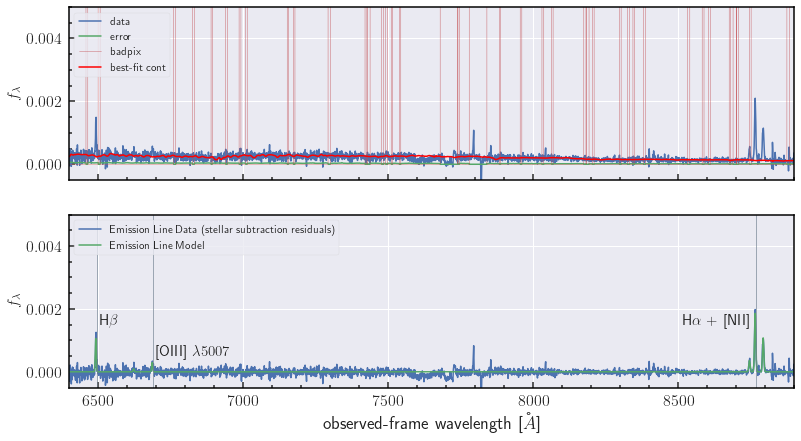

In [27]:
fig, ax1, ax2 = sf.plot_pyparadise_results(cube,prefix=bernd_run, redshift=zstar, zgas=zgas, pixel=(8,13), 
                                            custom_y_limits=[-0.0005,0.005], custom_x_limits=[6400, 8900], 
                                            draw_spectral_lines=True, paradise_app_path=paradise_path)


# fig.savefig(fig_path + 'gmos_pypar_fit.pdf')
    

### 3. Check PPXF Fit Emission Lines Results

1. Go to *Analysis/gmosbeads/ppfx/run_fit/* and run `python run_ppxf_sdss.py 0.336 1` in terminal (or here)
2. Run the cells below to plot the emission line fits

The fits to the gas are good! the crazy values will be filtered out using the chi squared parameter in `notebook 2`

In [8]:
line_fit_path = ''.join((path_to_beads, 'Analysis/gmosBeads/ppxf/fit_results/plot_fit/run1/'))
ypixels = np.arange(5,30)
xpixels = np.arange(1,20)

In [ ]:
zfit=0

betaz = (0.083*np.power(1.0+zfit, 4) - 1.25*np.power(1.0+zfit, 3) + 5.92*np.power(1.0+zfit, 2) - 9.25*np.power(1.0+zfit, 1) + 6.5 )
ehaloz = (-1.06*np.power(1.0+zfit, 3) + 0.946*np.power(1.0+zfit, 2) +  0.445*np.power(1.0+zfit, 1) + 2.06)
veject = 100
epsilon_halo = 0.62*ehaloz*(0.5 + np.power((vvir/veject), -1 * betaz))

nan_treatment='interpolate', however, NaN values detected post convolution. A contiguous region of NaN values, larger than the kernel size, are present in the input array. Increase the kernel size to avoid this.
nan_treatment='interpolate', however, NaN values detected post convolution. A contiguous region of NaN values, larger than the kernel size, are present in the input array. Increase the kernel size to avoid this.
nan_treatment='interpolate', however, NaN values detected post convolution. A contiguous region of NaN values, larger than the kernel size, are present in the input array. Increase the kernel size to avoid this.


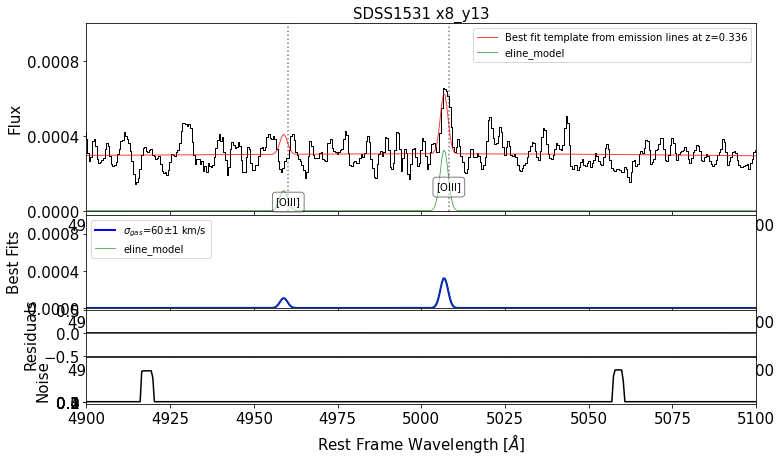

In [10]:
#check specific spaxel
xpix, ypix = 8, 13
xypixel = 'x{}_y{}'.format(xpix, ypix)
sf.plot_single_gaussian_fit(line_fit_path, xypixel, xlim=[4900, 5100], ylim=[0,0.001])

#### Plot All Fits

nan_treatment='interpolate', however, NaN values detected post convolution. A contiguous region of NaN values, larger than the kernel size, are present in the input array. Increase the kernel size to avoid this.
nan_treatment='interpolate', however, NaN values detected post convolution. A contiguous region of NaN values, larger than the kernel size, are present in the input array. Increase the kernel size to avoid this.
nan_treatment='interpolate', however, NaN values detected post convolution. A contiguous region of NaN values, larger than the kernel size, are present in the input array. Increase the kernel size to avoid this.
nan_treatment='interpolate', however, NaN values detected post convolution. A contiguous region of NaN values, larger than the kernel size, are present in the input array. Increase the kernel size to avoid this.
nan_treatment='interpolate', however, NaN values detected post convolution. A contiguous region of NaN values, larger than the kernel size, are present 

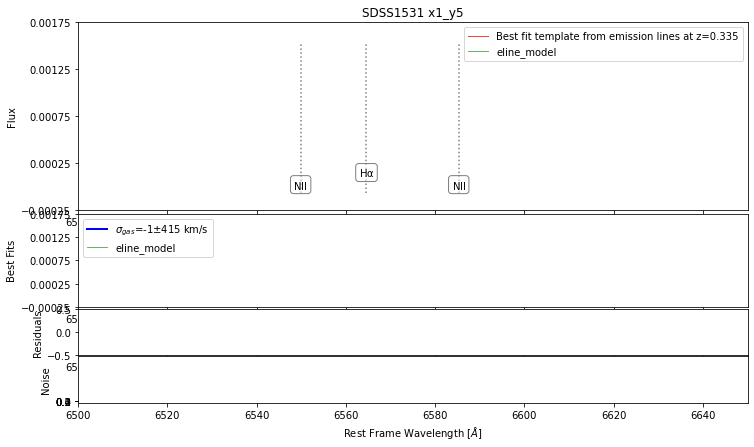

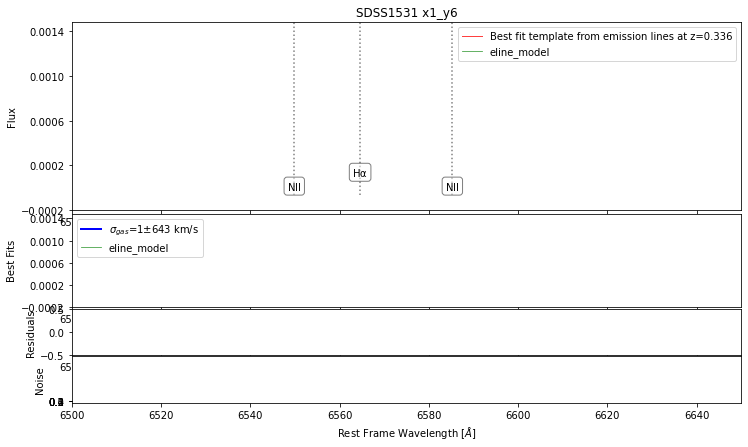

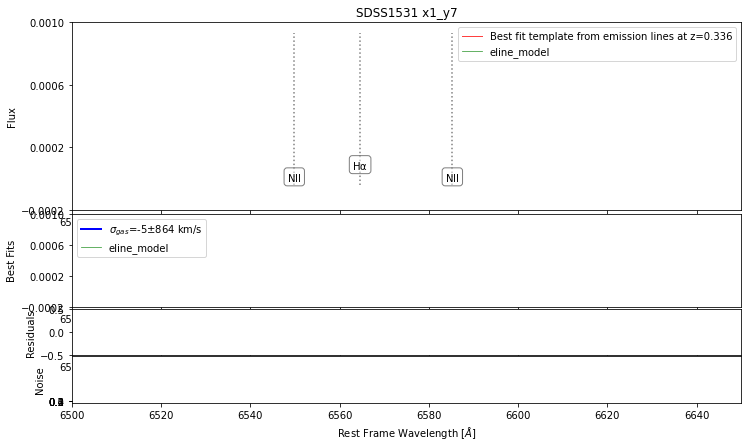

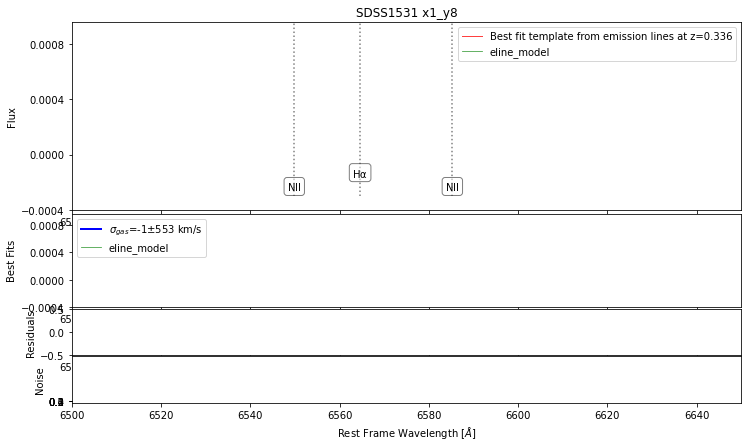

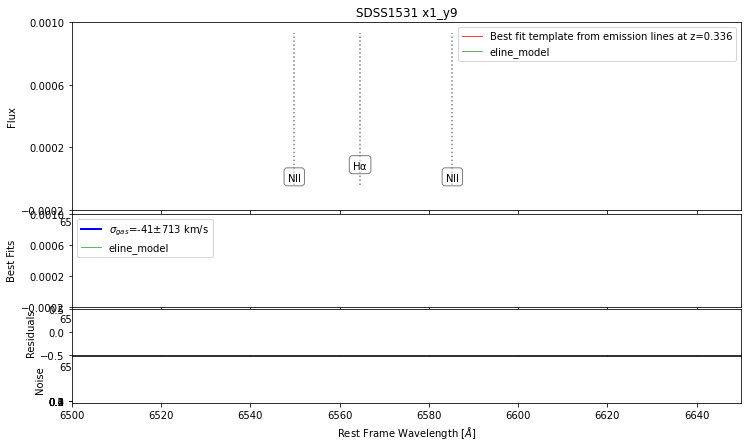

...

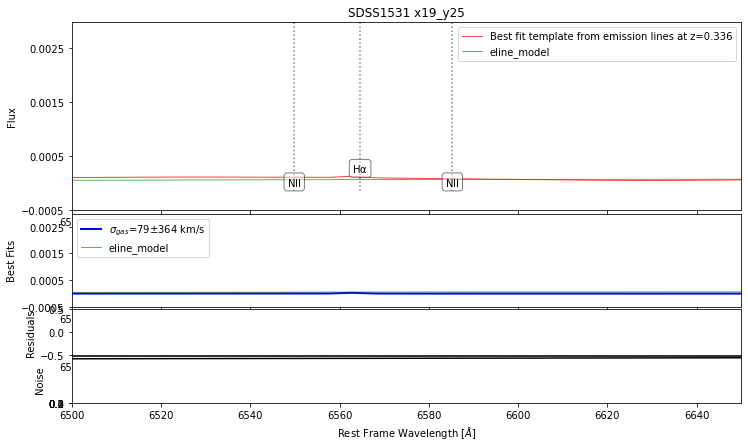

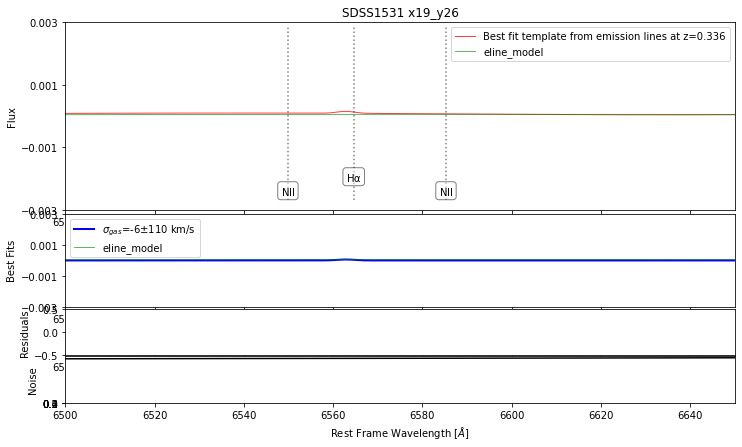

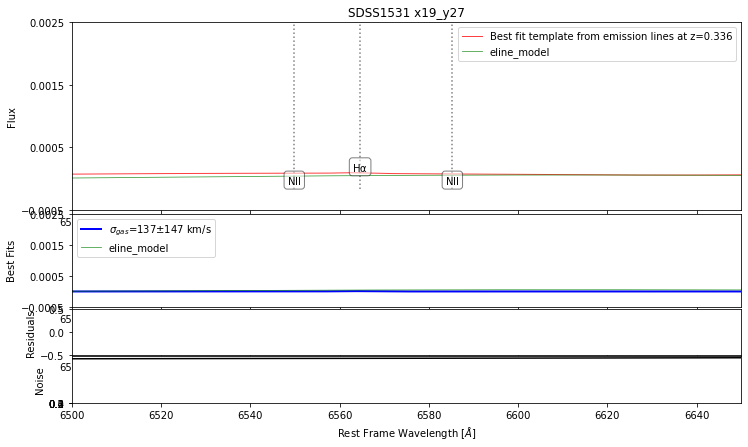

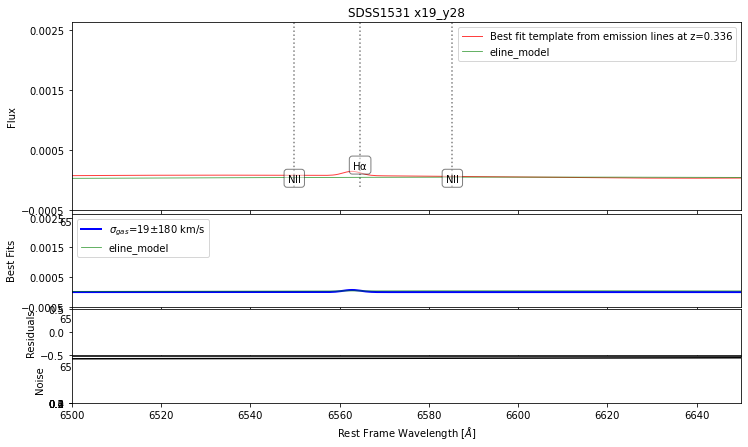

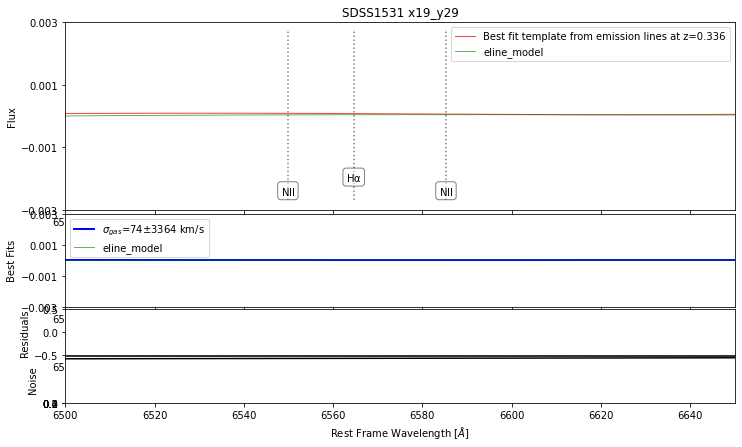

In [8]:
for xpix in xpixels:
    for ypix in ypixels:

        xypixel = 'x{}_y{}'.format(xpix, ypix)
        sf.plot_single_gaussian_fit(line_fit_path, xypixel, xlim=[6500, 6650])

### Plot PPXF and PyParadise Fit

In [28]:
from astropy.convolution import convolve, Box1DKernel

In [43]:
def plot_ppx_pyparadise_fit(cube_or_rss, prefix, pixel, redshift, paradise_app_path, ppxf_fit_path,
                            zgas=0, mask_cont=None, fit_line=None, draw_spectral_lines=True, 
                            custom_y_limits=None, custom_x_limits=None, fig_save_path=None):
    '''
    
    '''
    #Load Paradise App
    sys.path.insert(0,paradise_app_path) # You'll need to fix this for your path, obviously

    try: 
        import PyParadise
        import ParadiseApp
        print('ParadiseApp successfully imported')
    except ImportError as error:
        print(f'ERROR: {error}')

    #load Paradise data
    try:
        rss = PyParadise.spectrum1d.loadSpectrum(cube_or_rss)
    except IOError:
        print("Input data not found. Please check the file names.")
        sys.exit()
    try:
        cont = PyParadise.spectrum1d.loadSpectrum(f'{prefix}.cont_model.fits')
        res = PyParadise.spectrum1d.loadSpectrum(f'{prefix}.cont_res.fits')
    except IOError:
        print("PyParadise output data cannot be found. Please check the prefix for the file names.")
        sys.exit()
    try:
        line = PyParadise.spectrum1d.loadSpectrum(f'{prefix}.eline_model.fits')
        line_model_present = True
    except IOError:
        print("No emission line model found. I'll plot this without the line model.")
        line_model_present = False

    try:
        if type(pixel) == str:
            if ',' in pixel:
                cube_x = int(pixel.split(',')[0])-1
                cube_y = int(pixel.split(',')[1])-1
        elif type(pixel) == tuple:
                cube_x = int(pixel[0]-1)
                cube_y = int(pixel[1]-1)
        else:
            rss_fiber = int(pixel)-1
    except:
        print("Wrong format to select the spectrum. Please check your data format and syntax for the spectrum coordinates")
        sys.exit()
    
    #Load PPXF data
    pixel_file = 'x{}_y{}'.format(pixel[0], pixel[1])
    maskedgalaxy = np.load(ppxf_fit_path + '{}_sg_masked_galaxy.npy'.format(pixel_file))
    lowSN = np.load(ppxf_fit_path + '{}_sg_lowsn.npy'.format(pixel_file))
    wave = np.load(ppxf_fit_path + '{}_sg_wave.npy'.format(pixel_file))
    goodpixels = np.load(ppxf_fit_path + '{}_sg_goodpixels.npy'.format(pixel_file))
    pp_bestfit = np.load(ppxf_fit_path + '{}_sg_pp_bestfit.npy'.format(pixel_file))
    lambda_spec = np.load(ppxf_fit_path + '{}_sg_lambda_spec.npy'.format(pixel_file))
    zfit_gas = np.load(ppxf_fit_path + '{}_sg_zfitgas.npy'.format(pixel_file))
    eline_mod = np.load(ppxf_fit_path + '{}_sg_elinemod.npy'.format(pixel_file))
    sigma_gas = np.load(ppxf_fit_path + '{}_sg_sigma_gas.npy'.format(pixel_file))
    esigma_gas = np.load(ppxf_fit_path + '{}_sg_esigma_gas.npy'.format(pixel_file))
    noise = np.load(ppxf_fit_path + '{}_sg_noise.npy'.format(pixel_file))
    reflines = np.load(ppxf_fit_path + '{}_sg_reflines.npy'.format(pixel_file))

    gas = np.load(ppxf_fit_path + '{}_sg_gas.npy'.format(pixel_file))
    object_id = 'SDSS1531'

    #extract labels from each fit
    if reflines is not None:
        i_s = []
        ws = []
        labels = []

        for i,w,label in zip(range(len(reflines)),reflines['wave'],reflines['label']):
            i_s.append(i)
            ws.append(w)
            labels.append(label)
    
    #plot data
    z = redshift
    select = rss._error > 1e3
    rss._error[select] = 0

    i = 0
    plt.style.use('seaborn')
    plt.rcParams['axes.linewidth'] = 1.5
    plt.rcParams['axes.edgecolor'] = 'k'
    
    plt.close() # just in case
    fig, (ax1, ax2) = plt.subplots(2,1,  figsize=(13,7))

    if rss._datatype == 'CUBE':
        ax1.plot(rss._wave, rss._data[:, cube_y,
                 cube_x],  lw=1.5, label='Stellar + Emission Line Data')
        ax1.plot(rss._wave, rss._error[:, cube_y,
                 cube_x],  lw=1.5, label='Error')
        # if rss._mask is not None:
        #     ax1.plot(rss._wave, rss._mask[:, cube_y, cube_x]
        #              * 0.1, lw=0.5, alpha=0.8, label='badpix')
        ax1.plot(
            cont._wave, cont._data[:, cube_y, cube_x], '-r', lw=1.5, label='PyParadise Best-fit Stellar Continuum')
    elif rss._datatype == 'RSS':
        ax1.plot(rss._wave, rss._data[rss_fiber,
                 :],  lw=1.5, label='data')
        ax1.plot(rss._wave, rss._error[rss_fiber,
                 :],  lw=1.5, label='error')
        if rss._mask is not None:
            ax1.plot(rss._wave, rss._mask[rss_fiber, :]
                     * 0.1, lw=0.5, alpha=0.8, label='badpix')
        ax1.plot(cont._wave, cont._data[rss_fiber, :],
                  lw=1.5, label='best-fit cont')

    if mask_cont is not None:
        cont_mask = PyParadise.parameters.CustomMasks(mask_cont)
        for i in range(len(cont_mask['rest_frame'])):
            if i == 0:
                masklabel = mask_cont + ' (Rest frame)'
            else:
                masklabel = None
            ax1.axvspan(cont_mask['rest_frame'][i][0]*(1+z), cont_mask['rest_frame']
                        [i][1]*(1+z), color='k', alpha=0.2, label=masklabel)
        for i in range(len(cont_mask['observed_frame'])):
            if i == 0:
                masklabel = mask_cont + ' (Obs. frame)'
            else:
                masklabel = None
            ax1.axvspan(cont_mask['observed_frame'][i][0], cont_mask['observed_frame']
                        [i][1], color='r', alpha=0.2, label=masklabel)

    leg = ax1.legend(loc='upper left', fontsize=11)
    leg.draw_frame(True)

    if line_model_present:
        ##PXF
        #plotting smoothed spectrum
        smoothing_fact = 5

        ax2.plot(rss._wave, rss._data[:, cube_y,cube_x],
                    linewidth=1.5, label='Emission Line Data (stellar subtraction residuals)')

        # overplot best fit alone
        ax2.plot(wave*(1+zgas), pp_bestfit, linewidth=1.5, label='pPXF Best-fit Emission Lines')

        leg2 = ax2.legend(loc='upper left', fontsize=11)
        leg2.draw_frame(True)
    ax1.set_ylabel(r'$f_\lambda$', fontsize=16)
    ax1.minorticks_on()
    ax1.tick_params(axis='both', which='major', direction='in',
                    width=1.5, length=6, labelsize=16)
    ax1.tick_params(axis='both', which='minor',
                    direction='in', width=1.5, length=3)
    ax1.set_xticklabels([])
    ax2.minorticks_on()
    ax2.tick_params(axis='both', which='major', direction='in',
                    width=1.5, length=6, labelsize=16)
    ax2.tick_params(axis='both', which='minor',
                    direction='in', width=1.5, length=3)

    ax2.set_xlabel('observed-frame wavelength [$\AA$]', fontsize=18)
    ax2.set_ylabel(r'$f_\lambda$', fontsize=16)
    
    if draw_spectral_lines is True:
        spectral_line_dict = {
                     r'H$\beta$': 4862.68,
                     r'[OIII] $\lambda 5007$': 5006.84,
                      r'H$\alpha$ + [NII]': 6562.80,
                     }
        dxval, yval = [10, 10, -250], [0.0015, 0.0005, 0.0015]
        for idl, line in enumerate(spectral_line_dict):
            # ax2.axvline(spectral_line_dict[line] * (1 + zgas), lw=0.8, alpha=0.8, color='slategray')
            ax2.text(spectral_line_dict[line] * (1 + zgas) + dxval[idl], yval[idl], f'{line}')
    
    if custom_y_limits is not None:
        ax1.set_ylim(custom_y_limits)
        ax2.set_ylim(custom_y_limits)

    if custom_x_limits is not None:
        ax1.set_xlim(custom_x_limits)
        ax2.set_xlim(custom_x_limits)
    # plt.tight_layout()
    if fig_save_path is not None:
        plt.savefig(fig_save_path, dpi=300)
    plt.show()

    return fig, ax1, ax2

In [44]:
ppxf_path = ''.join((path_to_beads, 'Analysis/gmosBeads/ppxf/fit_results/plot_fit/run1/'))

ParadiseApp successfully imported


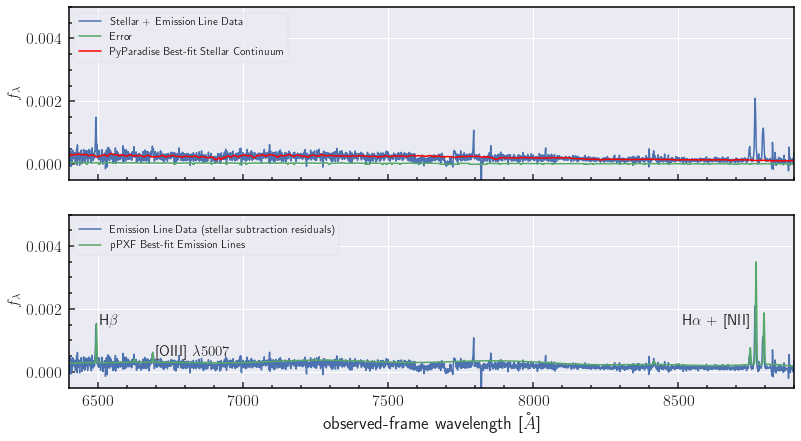

In [46]:
fig, ax1, ax2 = plot_ppx_pyparadise_fit(cube,prefix=bernd_run, redshift=zstar, zgas=zgas, pixel=(8,13), 
                                            paradise_app_path=paradise_path, ppxf_fit_path=ppxf_path,
                                            custom_y_limits=[-0.0005,0.005], custom_x_limits=[6400, 8900], 
                                            draw_spectral_lines=True)

fig.savefig(fig_path + 'gmos_pypar_ppxf_fit.pdf')